Import all the necessary libraries.

In [59]:
from tensorflow import keras
from tensorflow.keras import layers
import pathlib
from tensorflow.keras.utils import image_dataset_from_directory

import pandas as pd
import pathlib
from pathlib import Path

import numpy as np
import pandas as pd

# plotting modules
from matplotlib import pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split

import plotly as plotly
plotly.offline.init_notebook_mode()

from tensorflow import keras
from tensorflow.keras import layers

import tensorflow as tf
from keras.utils import to_categorical
from keras.models import load_model

import plotly.graph_objects as go
from tensorflow.keras.models import Sequential
from keras.callbacks import ModelCheckpoint
from tensorflow.keras.layers import Dense
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report, precision_recall_curve, ConfusionMatrixDisplay

# Framing the problem

The goal of this lab is to work through a common practice of Deep Learning Engineers - that is - take an existing model, that does something similar to what the engineer is interested doing, and fine-tune it for the specific task at-hand.

# Getting the data

For this report, we will be downloading the data from Kaggle. 

In [405]:
data_folder = pathlib.Path('../../CSCN8010-Foundations-of-Machine-Learning/data/dogs-vs-cats-small')

We will use the below function and code to get the image datasets from the folder directory.

In [406]:
train_dataset = image_dataset_from_directory(
    data_folder / "train",
    image_size=(180, 180),
    batch_size=32)
validation_dataset = image_dataset_from_directory(
    data_folder / "validation",
    image_size=(180, 180),
    batch_size=32)
test_dataset = image_dataset_from_directory(
    data_folder / "test",
    image_size=(180, 180),
    batch_size=32)

Found 2000 files belonging to 2 classes.
Found 1000 files belonging to 2 classes.
Found 2000 files belonging to 2 classes.


In [407]:
test_dataset

<_BatchDataset element_spec=(TensorSpec(shape=(None, 180, 180, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None,), dtype=tf.int32, name=None))>

Then the function and the code in the block below will covert the datasets into features and labels that we can now interact with.

We will talking about the `conv_base` later. But for now, we need it to extract our features and labels.

In [408]:
conv_base = keras.applications.vgg16.VGG16(
    weights="imagenet",
    include_top=False,
    input_shape=(180, 180, 3))

In [409]:
import numpy as np

def get_features_and_labels(dataset):
    all_features = []
    all_labels = []
    for images, labels in dataset:
        preprocessed_images = keras.applications.vgg16.preprocess_input(images)
        features = conv_base.predict(preprocessed_images)
        all_features.append(features)
        all_labels.append(labels)
    return np.concatenate(all_features), np.concatenate(all_labels)

train_features, train_labels =  get_features_and_labels(train_dataset)
val_features, val_labels =  get_features_and_labels(validation_dataset)
test_features, test_labels =  get_features_and_labels(test_dataset)

1/1 [==============================] - 2s 2s/step


In [410]:
train_features.shape, val_features.shape, test_features.shape

((2000, 5, 5, 512), (1000, 5, 5, 512), (2000, 5, 5, 512))

In [411]:
train_labels

array([1, 0, 1, ..., 1, 0, 1])

# Exploratory Data Analysis

Let us first put our data into a usable format we can explore.

In [60]:
def create_image_dataframe(base_folder, dataset_type):
    # Initialize a list to store the information
    data = []
    dataset_folder = base_folder / dataset_type  # e.g., 'train', 'validation', 'test'
    
    # Iterate through each subfolder ('cat' and 'dog') in the given directory
    for subfolder in ['cat', 'dog']:
        full_subfolder_path = dataset_folder / subfolder
        
        # Iterate through each image file in the subfolder
        for image_path in full_subfolder_path.glob('*.jpg'):
            # Construct a concise relative path in the format "train/cat"
            concise_path = f"{dataset_type}/{subfolder}/{image_path.name}"
            
            # Extract the image name (file name without the extension)
            image_name = image_path.stem
            
            # The label is determined by the subfolder name
            label = subfolder
            
            # Append the information to the list
            data.append({'ImagePath': concise_path, 'ImageName': image_name, 'Label': label})
    
    # Create a DataFrame from the list
    return pd.DataFrame(data)

# Define the base path for the data
data_folder = Path('../../CSCN8010-Foundations-of-Machine-Learning/data/dogs-vs-cats-small')

# Create DataFrames for train, validation, and test sets
df_train = create_image_dataframe(data_folder, 'train')
df_validation = create_image_dataframe(data_folder, 'validation')
df_test = create_image_dataframe(data_folder, 'test')

# Display the first few rows of each DataFrame as a sanity check
print("Training Set:")
display(df_train.head())

print("\nValidation Set:")
display(df_validation.head())

print("\nTest Set:")
display(df_test.head())

Training Set:


,ImagePath,ImageName,Label
0,train/cat/cat.0.jpg,cat.0,cat
1,train/cat/cat.1.jpg,cat.1,cat
2,train/cat/cat.10.jpg,cat.10,cat
3,train/cat/cat.100.jpg,cat.100,cat
4,train/cat/cat.101.jpg,cat.101,cat



Validation Set:


,ImagePath,ImageName,Label
0,validation/cat/cat.1000.jpg,cat.1000,cat
1,validation/cat/cat.1001.jpg,cat.1001,cat
2,validation/cat/cat.1002.jpg,cat.1002,cat
3,validation/cat/cat.1003.jpg,cat.1003,cat
4,validation/cat/cat.1004.jpg,cat.1004,cat



Test Set:


,ImagePath,ImageName,Label
0,test/cat/cat.1500.jpg,cat.1500,cat
1,test/cat/cat.1501.jpg,cat.1501,cat
2,test/cat/cat.1502.jpg,cat.1502,cat
3,test/cat/cat.1503.jpg,cat.1503,cat
4,test/cat/cat.1504.jpg,cat.1504,cat


In [61]:
df_train['Set'] = 'Train'
df_validation['Set'] = 'Validation'
df_test['Set'] = 'Test'

# Concatenate the DataFrames
df_merged = pd.concat([df_train, df_validation, df_test], ignore_index=True)

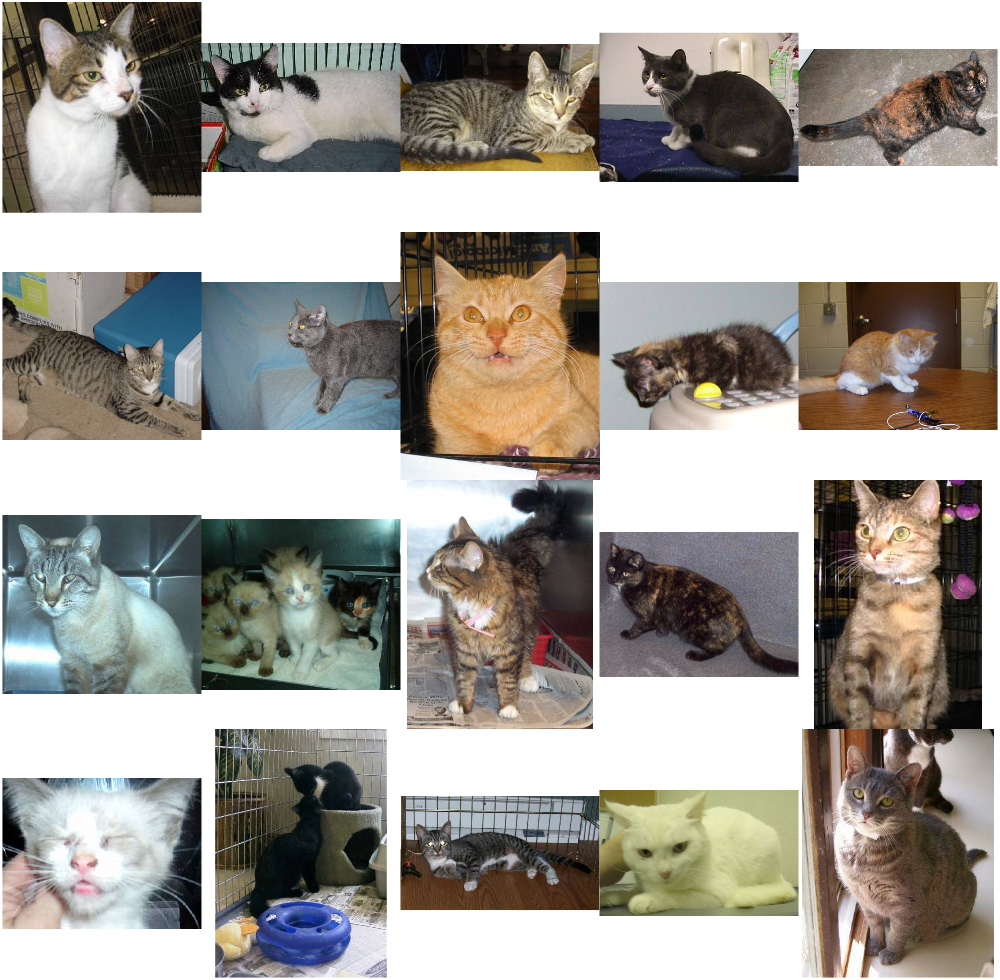

In [65]:
from PIL import Image


def plot_cat_images(df, base_folder, total_images=20, images_per_row=5):
    cat_df = df[df['Label'] == 'cat']
    plt.figure(figsize=(40, 40))
    
    for i in range(total_images):
        random_row = cat_df.sample(n=1).iloc[0]
        image_path = base_folder / random_row['ImagePath']
        
        image = Image.open(image_path)
        
        total_rows = total_images // images_per_row + int(total_images % images_per_row != 0)
        
        plt.subplot(total_rows, images_per_row, i+1)
        plt.imshow(image)
        plt.axis('off') 
    
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.tight_layout(pad=0)
    plt.show()

plot_cat_images(df_merged, data_folder)


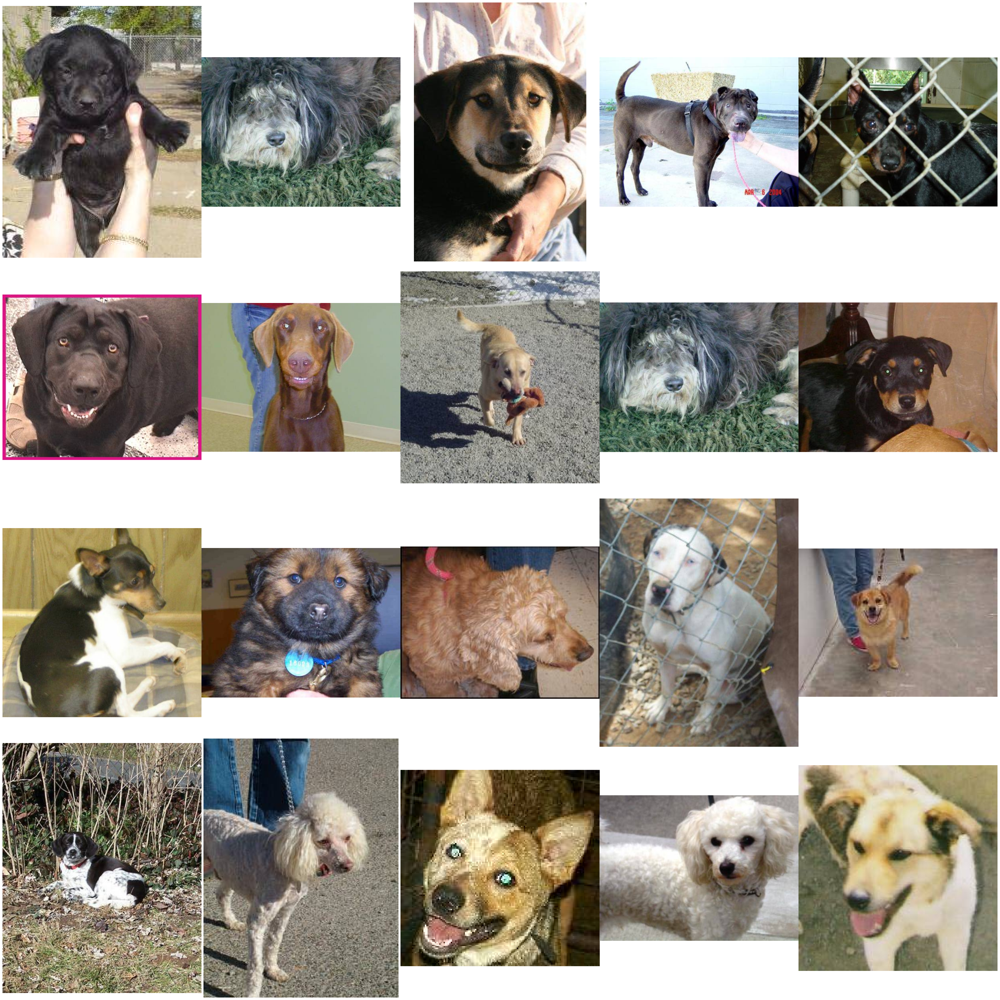

In [66]:
def plot_dog_images(df, base_folder, total_images=20, images_per_row=5):
    dog_df = df[df['Label'] == 'dog']
    plt.figure(figsize=(40, 40))
    
    for i in range(total_images):
        random_row = dog_df.sample(n=1).iloc[0]
        image_path = base_folder / random_row['ImagePath']
        
        image = Image.open(image_path)
        
        total_rows = total_images // images_per_row + int(total_images % images_per_row != 0)
        
        plt.subplot(total_rows, images_per_row, i+1)
        plt.imshow(image)
        plt.axis('off') 
    
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.tight_layout(pad=0)
    plt.show()

plot_dog_images(df_merged, data_folder)


In [417]:
import plotly.express as px

# Count the occurrences of each label in the dataset
label_counts = df_train['Label'].value_counts()

# Create a bar chart
fig = px.bar(x=label_counts.index, y=label_counts.values, labels={'x': 'Label', 'y': 'Count'}, title='Distribution of Cats and Dogs in the Training Dataset')

# Customize the chart appearance
fig.update_traces(marker_color=['blue', 'orange'], marker_line_color='rgb(8,48,107)', marker_line_width=1.5, opacity=0.6)

# Show the plot
fig.show()


In [418]:
import plotly.express as px

# Count the occurrences of each label in the dataset
label_counts = df_validation['Label'].value_counts()

# Create a bar chart
fig = px.bar(x=label_counts.index, y=label_counts.values, labels={'x': 'Label', 'y': 'Count'}, title='Distribution of Cats and Dogs in the Validation Dataset')

# Customize the chart appearance
fig.update_traces(marker_color=['blue', 'orange'], marker_line_color='rgb(8,48,107)', marker_line_width=1.5, opacity=0.6)

# Show the plot
fig.show()

In [419]:
import plotly.express as px

# Count the occurrences of each label in the dataset
label_counts = df_test['Label'].value_counts()

# Create a bar chart
fig = px.bar(x=label_counts.index, y=label_counts.values, labels={'x': 'Label', 'y': 'Count'}, title='Distribution of Cats and Dogs in the Test Dataset')

# Customize the chart appearance
fig.update_traces(marker_color=['blue', 'orange'], marker_line_color='rgb(8,48,107)', marker_line_width=1.5, opacity=0.6)

# Show the plot
fig.show()


We have an equal and balanced distribution of cat and dog in our datasets. And this is in the train, validation and test datasets. This would help in training our model.

Next we explore the distribution of the image width and height of our combined dataset.

In [420]:
from PIL import Image

# Function to get image dimensions
def get_image_dimensions(image_path):
    with Image.open(image_path) as img:
        return img.size  # width, height

# Apply the function to the DataFrame
df_merged['Dimensions'] = df_merged['ImagePath'].apply(lambda x: get_image_dimensions(data_folder / x))

# Split dimensions into separate columns
df_merged['Width'], df_merged['Height'] = zip(*df_merged['Dimensions'])

# Plot distributions of widths and heights
fig_widths = px.histogram(df_merged, x='Width', title='Distribution of Image Widths')
fig_heights = px.histogram(df_merged, x='Height', title='Distribution of Image Heights')

fig_widths.show()
fig_heights.show()


Looking at the image width, we can see that most of the images are within the 250 to 450 pixels. We also have about 40% of the images that are 490 to 510 pixels wide and then a couple of outliers at 1020 and 1050 pixels.

Similarly for the image height, we have most of our image height from 200px to 510px, with a large number between 370 to 379 pixels and then another group at 490px to 510px. Also, there is the presence of some outliers at 760px.

In [421]:
# Basic counts
total_images = len(df_merged)
num_cats = len(df_merged[df_merged['Label'] == 'cat'])
num_dogs = len(df_merged[df_merged['Label'] == 'dog'])

print(f"Total images: {total_images}")
print(f"Number of cat images: {num_cats}")
print(f"Number of dog images: {num_dogs}")

# Proportions
prop_cats = num_cats / total_images * 100
prop_dogs = num_dogs / total_images * 100

print(f"Proportion of cat images: {prop_cats:.2f}%")
print(f"Proportion of dog images: {prop_dogs:.2f}%")


Total images: 5000
Number of cat images: 2500
Number of dog images: 2500
Proportion of cat images: 50.00%
Proportion of dog images: 50.00%


Here we can also see it in terms of numbers that we have an evenly distributed dataset between our two classes.

In [422]:
fig = px.pie(names=df_merged['Label'].value_counts().index, values=df_merged['Label'].value_counts().values, title='Class Distribution in the Dataset')
fig.show()

As viewed on a pie chart.

In [423]:
from PIL import Image

# Function to get image dimensions
def get_image_dimensions(image_path):
    with Image.open(image_path) as img:
        return img.size  # Returns (width, height)

# Apply the function to the dataset to create new columns for width and height
df_merged['Dimensions'] = df_merged['ImagePath'].apply(lambda x: get_image_dimensions(data_folder / x))
df_merged['Width'], df_merged['Height'] = zip(*df_merged['Dimensions'])

# Descriptive statistics for image dimensions
print(df_merged[['Width', 'Height']].describe())


             Width       Height
count  5000.000000  5000.000000
mean    403.882600   360.564600
std     108.659451    96.611042
min      59.000000    41.000000
25%     322.000000   300.000000
50%     440.000000   374.000000
75%     499.000000   418.250000
max    1050.000000   768.000000


Below we have the intensity value of the RGB aof the images across our entire dataset.

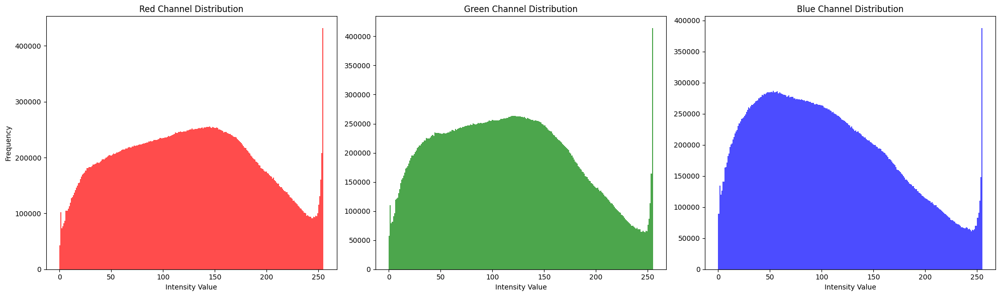

In [424]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

def plot_rgb_distribution(df, base_folder, sample_size=5000):
    # Sample a subset of the DataFrame
    sampled_df = df.sample(n=sample_size, random_state=42)

    # Initialize lists to store RGB values
    r_values, g_values, b_values = [], [], []

    # Loop through the sampled DataFrame and extract RGB values
    for _, row in sampled_df.iterrows():
        image_path = base_folder / row['ImagePath']
        with Image.open(image_path) as img:
            img = img.resize((100, 100))  # Resize to reduce computation
            r, g, b = np.array(img).T  # Transpose to split RGB
            r_values.extend(r.flatten())
            g_values.extend(g.flatten())
            b_values.extend(b.flatten())

    # Plot histograms for R, G, B distributions
    plt.figure(figsize=(20, 6))

    plt.subplot(1, 3, 1)
    plt.hist(r_values, bins=256, color='red', alpha=0.7)
    plt.title('Red Channel Distribution')
    plt.xlabel('Intensity Value')
    plt.ylabel('Frequency')

    plt.subplot(1, 3, 2)
    plt.hist(g_values, bins=256, color='green', alpha=0.7)
    plt.title('Green Channel Distribution')
    plt.xlabel('Intensity Value')

    plt.subplot(1, 3, 3)
    plt.hist(b_values, bins=256, color='blue', alpha=0.7)
    plt.title('Blue Channel Distribution')
    plt.xlabel('Intensity Value')

    plt.tight_layout()
    plt.show()

# Assuming df_merged and data_folder are already defined
plot_rgb_distribution(df_merged, data_folder)


We can also visualize our dataset using the aggregated RGB values and see the pixel distribution.

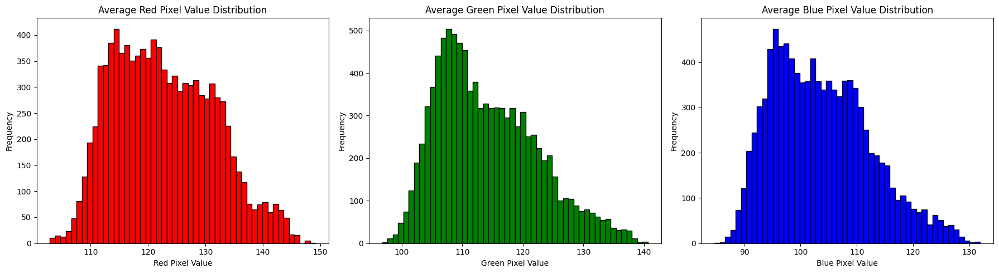

In [425]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

def compute_average_rgb_distribution(df, base_folder, sample_size=100):
    # Initialize lists to store RGB values
    red_values, green_values, blue_values = [], [], []
    
    # Sample a subset of images to avoid memory issues
    sampled_df = df.sample(n=sample_size)
    
    for _, row in sampled_df.iterrows():
        image_path = base_folder / row['ImagePath']
        image = Image.open(image_path)
        image = image.resize((100, 100))  # Resize to standardize size
        image_np = np.array(image)
        
        # Append RGB values
        red_values.append(image_np[:, :, 0].flatten())
        green_values.append(image_np[:, :, 1].flatten())
        blue_values.append(image_np[:, :, 2].flatten())
    
    # Convert lists to Numpy arrays and compute mean across all sampled images
    red_values = np.mean(np.array(red_values), axis=0)
    green_values = np.mean(np.array(green_values), axis=0)
    blue_values = np.mean(np.array(blue_values), axis=0)
    
    # Plot the distributions
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))
    colors = ['Red', 'Green', 'Blue']
    for i, (data, color) in enumerate(zip([red_values, green_values, blue_values], colors)):
        axes[i].hist(data, bins=50, color=color.lower(), edgecolor='black')
        axes[i].set_title(f'Average {color} Pixel Value Distribution')
        axes[i].set_xlabel(f'{color} Pixel Value')
        axes[i].set_ylabel('Frequency')

    plt.tight_layout()
    plt.show()

# Assuming df_merged and data_folder are already defined
compute_average_rgb_distribution(df_merged, data_folder)


Our dataset shows a normal distribution across each of the Red, Green and Blue values in our images.

# Modeling

## Model 1 - Vanilla Model

In this model, we will be defining a model of our choice, from scratch.

We will be using a neural dense network of only two trainable layers for our modeling. Simple stuff, really. Nothing complicated.

In [426]:
inputs = keras.Input(shape=(5, 5, 512))
x = layers.Flatten()(inputs)
x = layers.Dense(256)(x)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)
model_1 = keras.Model(inputs, outputs)

In [427]:
model_1.summary()

Model: "model_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_28 (InputLayer)       [(None, 5, 5, 512)]       0         
                                                                 
 flatten_15 (Flatten)        (None, 12800)             0         
                                                                 
 dense_32 (Dense)            (None, 256)               3277056   
                                                                 
 dropout_16 (Dropout)        (None, 256)               0         
                                                                 
 dense_33 (Dense)            (None, 1)                 257       
                                                                 
Total params: 3,277,313
Trainable params: 3,277,313
Non-trainable params: 0
_________________________________________________________________


In [428]:
model_1.compile(loss="binary_crossentropy",
              optimizer="rmsprop",
              metrics=["accuracy"])

callbacks = [
    keras.callbacks.ModelCheckpoint(
      filepath="./models/vanilla.keras",
      save_best_only=True,
      monitor="val_loss")
]
history_1 = model_1.fit(
    train_features, train_labels,
    epochs=30,
    validation_data=(val_features, val_labels),
    callbacks=callbacks)

Epoch 1/30
63/63 [==============================] - 3s 38ms/step - loss: 12.2970 - accuracy: 0.9305 - val_loss: 4.8654 - val_accuracy: 0.9620
Epoch 2/30
63/63 [==============================] - 2s 30ms/step - loss: 4.4486 - accuracy: 0.9725 - val_loss: 3.1877 - val_accuracy: 0.9740
Epoch 3/30
63/63 [==============================] - 2s 29ms/step - loss: 1.6767 - accuracy: 0.9850 - val_loss: 3.3061 - val_accuracy: 0.9750
Epoch 4/30
63/63 [==============================] - 2s 32ms/step - loss: 1.9543 - accuracy: 0.9910 - val_loss: 6.1227 - val_accuracy: 0.9720
Epoch 5/30
63/63 [==============================] - 2s 30ms/step - loss: 0.8609 - accuracy: 0.9930 - val_loss: 5.5530 - val_accuracy: 0.9660
Epoch 6/30
63/63 [==============================] - 2s 29ms/step - loss: 2.2027 - accuracy: 0.9880 - val_loss: 4.9896 - val_accuracy: 0.9790
Epoch 7/30
63/63 [==============================] - 2s 29ms/step - loss: 0.4942 - accuracy: 0.9960 - val_loss: 6.5941 - val_accuracy: 0.9770
Epoch 8/30
6

In [429]:
history_df = pd.DataFrame(history_1.history)
history_df.insert(0, 'epoch', range(1, len(history_df) + 1))
history_df

,epoch,loss,accuracy,val_loss,val_accuracy
0,1,1.229699e+01,0.9305,4.865433,0.962
1,2,4.448617e+00,0.9725,3.187708,0.974
2,3,1.676736e+00,0.9850,3.306071,0.975
3,4,1.954285e+00,0.9910,6.122653,0.972
4,5,8.609466e-01,0.9930,5.553020,0.966
5,6,2.202713e+00,0.9880,4.989601,0.979
6,7,4.942128e-01,0.9960,6.594050,0.977
7,8,3.217583e-01,0.9970,5.469166,0.980
8,9,2.089501e-01,0.9985,4.776286,0.979
9,10,2.012045e-01,0.9970,4.361650,0.981


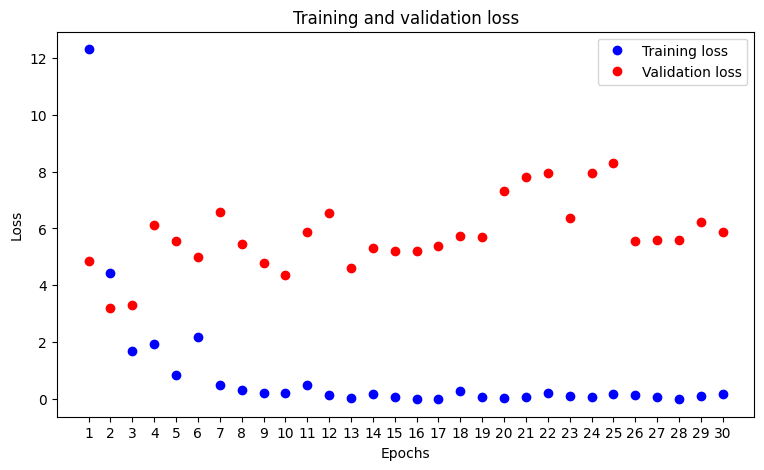

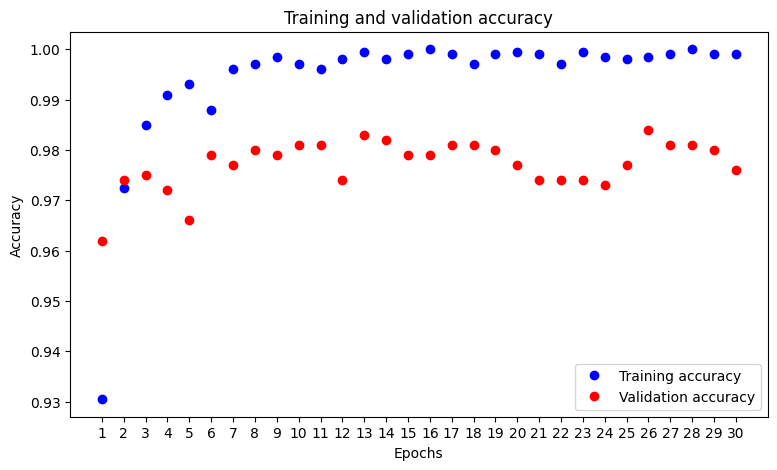

In [430]:
# Create a DataFrame from the history object
history_df = pd.DataFrame(history_1.history)

# Plot the training and validation loss
plt.figure(figsize=(9, 5))
values = history_df['accuracy']
epochs = range(1, len(values) + 1)
plt.plot(epochs, history_df['loss'], 'bo', label='Training loss')
plt.plot(epochs, history_df['val_loss'], 'ro', label='Validation loss')

plt.xlabel('Epochs')
plt.xticks(epochs)
plt.ylabel('Loss')
plt.legend()
plt.title('Training and validation loss')
plt.show()

# Plot the training and validation accuracy
plt.figure(figsize=(9, 5))
plt.plot(epochs, history_df['accuracy'], 'bo', label='Training accuracy')
plt.plot(epochs, history_df['val_accuracy'], 'ro', label='Validation accuracy')

plt.xlabel('Epochs')
plt.xticks(epochs)
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training and validation accuracy')
plt.show()

In [431]:
# Create a DataFrame from the history object
history_df = pd.DataFrame(history_1.history)

epochs = list(range(1, len(history_df['loss']) + 1))

# Plot the training and validation loss
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs, y=history_df['loss'], mode='lines+markers', name='Training loss'))
fig.add_trace(go.Scatter(x=epochs, y=history_df['val_loss'], mode='lines+markers', name='Validation loss'))
fig.update_layout(title='Training and validation loss', xaxis_title='Epochs', yaxis_title='Loss', xaxis=dict(tickvals=epochs))
fig.show()

# Plot the training and validation accuracy
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs, y=history_df['accuracy'], mode='lines+markers', name='Training accuracy'))
fig.add_trace(go.Scatter(x=epochs, y=history_df['val_accuracy'], mode='lines+markers', name='Validation accuracy'))
fig.update_layout(title='Training and validation accuracy', xaxis_title='Epochs', yaxis_title='Accuracy', xaxis=dict(tickvals=epochs))
fig.show()

We can see that on epoch 26, we attained the highest accuracy on our validation data at `0.984` and we had our lowest loss on the validation data at epoch 2, with `3.18`.

This is the performance on the test set, we will dive into this later.

In [432]:
best_model_1 = keras.models.load_model(
    "./models/vanilla.keras")
test_loss, test_acc = best_model_1.evaluate(x=test_features, y=test_labels)
print(f"Test accuracy: {test_acc:.3f}")

63/63 [==============================] - 1s 12ms/step - loss: 5.0883 - accuracy: 0.9700
Test accuracy: 0.970


## Model 2 - Fine-Tune VGG16

For this model, we will be using the already pretrained VGG16 model.

As a way to fine tune this model for our case, we will be excluding the top layers from the VGG16 model because this model has already been trained with the ImageNet data but we are not working with the ImageNet data here.

In [433]:
conv_base = keras.applications.vgg16.VGG16(
    weights="imagenet",
    include_top=False,
    )

In [434]:
conv_base.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_29 (InputLayer)       [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

In [435]:
conv_base.trainable = False
conv_base.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_29 (InputLayer)       [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

Here we will initialize our model, we have defined the kind of input it is to expect and the output. Notice the use of the `sigmoid` activation function here and only one output neuron for our binary classification.

In [436]:
inputs = keras.Input(shape=(180, 180, 3))
x = keras.applications.vgg16.preprocess_input(inputs)
x = conv_base(x)
x = layers.Flatten()(x)
x = layers.Dense(256)(x)
x = layers.Dropout(0.5)(x)
outputs = layers.Dense(1, activation="sigmoid")(x)
model_2 = keras.Model(inputs, outputs)

In [437]:
model_2.summary()

Model: "model_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_30 (InputLayer)       [(None, 180, 180, 3)]     0         
                                                                 
 tf.__operators__.getitem_11  (None, 180, 180, 3)      0         
  (SlicingOpLambda)                                              
                                                                 
 tf.nn.bias_add_11 (TFOpLamb  (None, 180, 180, 3)      0         
 da)                                                             
                                                                 
 vgg16 (Functional)          (None, None, None, 512)   14714688  
                                                                 
 flatten_16 (Flatten)        (None, 12800)             0         
                                                                 
 dense_34 (Dense)            (None, 256)               327

In [438]:
conv_base.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_29 (InputLayer)       [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

Another fine tuning we will do to the VGG16 model is to only train the last 4 layers and freeze the rest leaving them as they were. 

Retraining all the layers would generate a new set of weights entirely and would take away the point of using a pretrained model. Also, if we just used all the same weights as they came, we would not be adapting it to our particular dataset.

In [439]:
conv_base.trainable = True
for layer in conv_base.layers[:-4]:
    layer.trainable = False

In [440]:
model_2.summary()

Model: "model_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_30 (InputLayer)       [(None, 180, 180, 3)]     0         
                                                                 
 tf.__operators__.getitem_11  (None, 180, 180, 3)      0         
  (SlicingOpLambda)                                              
                                                                 
 tf.nn.bias_add_11 (TFOpLamb  (None, 180, 180, 3)      0         
 da)                                                             
                                                                 
 vgg16 (Functional)          (None, None, None, 512)   14714688  
                                                                 
 flatten_16 (Flatten)        (None, 12800)             0         
                                                                 
 dense_34 (Dense)            (None, 256)               327

In [441]:
conv_base.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_29 (InputLayer)       [(None, None, None, 3)]   0         
                                                                 
 block1_conv1 (Conv2D)       (None, None, None, 64)    1792      
                                                                 
 block1_conv2 (Conv2D)       (None, None, None, 64)    36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, None, None, 64)    0         
                                                                 
 block2_conv1 (Conv2D)       (None, None, None, 128)   73856     
                                                                 
 block2_conv2 (Conv2D)       (None, None, None, 128)   147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, None, None, 128)   0     

You can see the number of parameters we are training now out of all the total parameters.

In [442]:
model_2.summary()

Model: "model_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_30 (InputLayer)       [(None, 180, 180, 3)]     0         
                                                                 
 tf.__operators__.getitem_11  (None, 180, 180, 3)      0         
  (SlicingOpLambda)                                              
                                                                 
 tf.nn.bias_add_11 (TFOpLamb  (None, 180, 180, 3)      0         
 da)                                                             
                                                                 
 vgg16 (Functional)          (None, None, None, 512)   14714688  
                                                                 
 flatten_16 (Flatten)        (None, 12800)             0         
                                                                 
 dense_34 (Dense)            (None, 256)               327

You will notice the multiple printing of the model summary after each operation. This is a way for me to keep track of the trainable and non-trainable parameters.

Now, we have `10,356,737` parameters that we are trying to train for this model. We will now proceed to do that.

In [443]:
model_2.compile(loss="binary_crossentropy",
              optimizer=keras.optimizers.RMSprop(learning_rate=1e-5),
              metrics=["accuracy"])

callbacks = [
    keras.callbacks.ModelCheckpoint(
        filepath="./models/finetune-vgg16.keras",
        save_best_only=True,
        monitor="val_loss")
]
history_2 = model_2.fit(
    train_dataset,
    epochs=30 ,
    validation_data=validation_dataset,
    callbacks=callbacks)

Epoch 1/30


63/63 [==============================] - 333s 5s/step - loss: 3.9673 - accuracy: 0.7900 - val_loss: 0.6739 - val_accuracy: 0.9310
Epoch 2/30
63/63 [==============================] - 349s 6s/step - loss: 0.8357 - accuracy: 0.9240 - val_loss: 0.4260 - val_accuracy: 0.9440
Epoch 3/30
63/63 [==============================] - 226s 4s/step - loss: 0.3510 - accuracy: 0.9555 - val_loss: 0.3907 - val_accuracy: 0.9480
Epoch 4/30
63/63 [==============================] - 175s 3s/step - loss: 0.1987 - accuracy: 0.9760 - val_loss: 0.3240 - val_accuracy: 0.9530
Epoch 5/30
63/63 [==============================] - 175s 3s/step - loss: 0.1396 - accuracy: 0.9825 - val_loss: 0.4348 - val_accuracy: 0.9490
Epoch 6/30
63/63 [==============================] - 177s 3s/step - loss: 0.0939 - accuracy: 0.9875 - val_loss: 0.3031 - val_accuracy: 0.9660
Epoch 7/30
63/63 [==============================] - 176s 3s/step - loss: 0.0501 - accuracy: 0.9900 - val_loss: 0.3591 - val_accuracy: 0.9580
Epoch 8/30
63/63 [======

In [444]:
history_df = pd.DataFrame(history_2.history)
history_df.insert(0, 'epoch', range(1, len(history_df) + 1))
history_df

,epoch,loss,accuracy,val_loss,val_accuracy
0,1,3.967278,0.7900,0.673886,0.931
1,2,0.835655,0.9240,0.425955,0.944
2,3,0.350983,0.9555,0.390702,0.948
3,4,0.198697,0.9760,0.324017,0.953
4,5,0.139607,0.9825,0.434827,0.949
5,6,0.093875,0.9875,0.303122,0.966
6,7,0.050138,0.9900,0.359109,0.958
7,8,0.035728,0.9910,0.315623,0.964
8,9,0.009566,0.9975,0.315540,0.963
9,10,0.033070,0.9940,0.393651,0.962


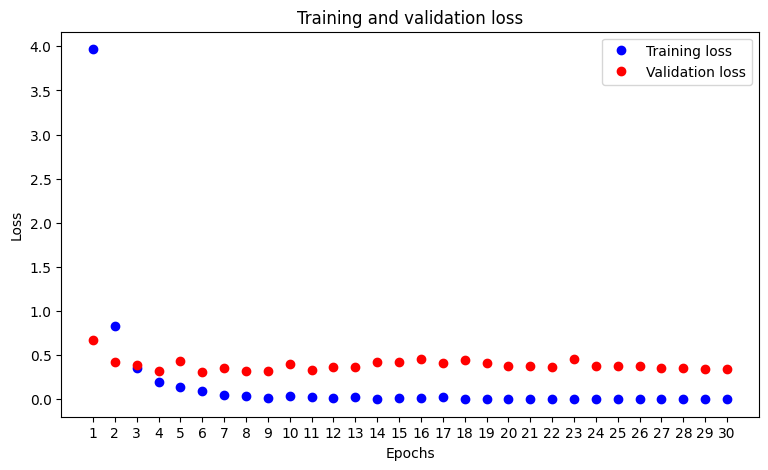

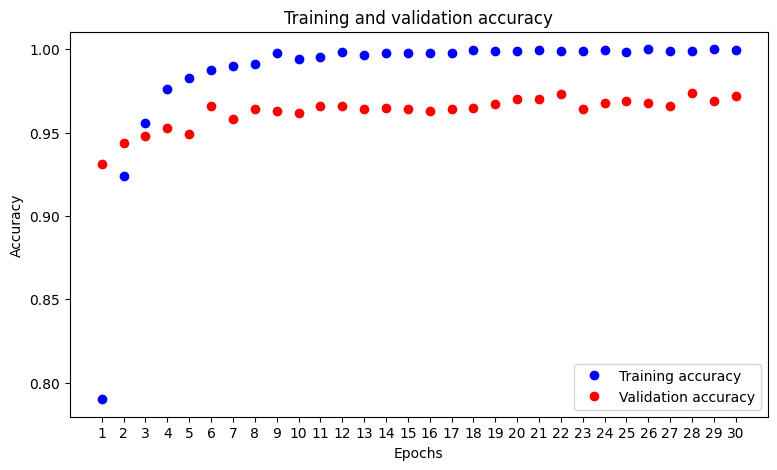

In [445]:
history_df = pd.DataFrame(history_2.history)

# Plot the training and validation loss
plt.figure(figsize=(9, 5))
values = history_df['accuracy']
epochs = range(1, len(values) + 1)
plt.plot(epochs, history_df['loss'], 'bo', label='Training loss')
plt.plot(epochs, history_df['val_loss'], 'ro', label='Validation loss')

plt.xlabel('Epochs')
plt.xticks(epochs)
plt.ylabel('Loss')
plt.legend()
plt.title('Training and validation loss')
plt.show()

# Plot the training and validation accuracy
plt.figure(figsize=(9, 5))
plt.plot(epochs, history_df['accuracy'], 'bo', label='Training accuracy')
plt.plot(epochs, history_df['val_accuracy'], 'ro', label='Validation accuracy')

plt.xlabel('Epochs')
plt.xticks(epochs)
plt.ylabel('Accuracy')
plt.legend()
plt.title('Training and validation accuracy')
plt.show()

In [446]:
# Create a DataFrame from the history object
history_df = pd.DataFrame(history_2.history)

epochs = list(range(1, len(history_df['loss']) + 1))

# Plot the training and validation loss
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs, y=history_df['loss'], mode='lines+markers', name='Training loss'))
fig.add_trace(go.Scatter(x=epochs, y=history_df['val_loss'], mode='lines+markers', name='Validation loss'))
fig.update_layout(title='Training and validation loss', xaxis_title='Epochs', yaxis_title='Loss', xaxis=dict(tickvals=epochs))
fig.show()

# Plot the training and validation accuracy
fig = go.Figure()
fig.add_trace(go.Scatter(x=epochs, y=history_df['accuracy'], mode='lines+markers', name='Training accuracy'))
fig.add_trace(go.Scatter(x=epochs, y=history_df['val_accuracy'], mode='lines+markers', name='Validation accuracy'))
fig.update_layout(title='Training and validation accuracy', xaxis_title='Epochs', yaxis_title='Accuracy', xaxis=dict(tickvals=epochs))
fig.show()

From the graphs, analyzing the performance on the validation set, we can see that our model had the highest accuracy score of `97.4%` on epoch number 28 and had the lowest loss of `0.303` on epoch 5. We could also see that on the dataframe.

In [447]:
best_model_2 = keras.models.load_model("./models/finetune-vgg16.keras")
best_model_2.summary()

Model: "model_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_30 (InputLayer)       [(None, 180, 180, 3)]     0         
                                                                 
 tf.__operators__.getitem_11  (None, 180, 180, 3)      0         
  (SlicingOpLambda)                                              
                                                                 
 tf.nn.bias_add_11 (TFOpLamb  (None, 180, 180, 3)      0         
 da)                                                             
                                                                 
 vgg16 (Functional)          (None, None, None, 512)   14714688  
                                                                 
 flatten_16 (Flatten)        (None, 12800)             0         
                                                                 
 dense_34 (Dense)            (None, 256)               327

# Evaluation

## Model 1 Evaluation

### Accuracy

We will first use the `evaluate` method that comes with the keras model. It gives us our test loss and the test accuracy.

In [448]:
test_loss, test_acc = best_model_1.evaluate(x=test_features, y=test_labels)
print(f"Test accuracy: {test_acc:.3f}")

 1/63 [..............................] - ETA: 1s - loss: 7.8513e-20 - accuracy: 1.0000

63/63 [==============================] - 0s 6ms/step - loss: 5.0883 - accuracy: 0.9700
Test accuracy: 0.970


Now we will use the normal process we have been using to calculate our model performance.

In [449]:
y_test_pred = best_model_1.predict(test_features)

 1/63 [..............................] - ETA: 4s

63/63 [==============================] - 0s 5ms/step


In [450]:
y_test_pred

array([[1.],
       [1.],
       [0.],
       ...,
       [1.],
       [0.],
       [1.]], dtype=float32)

In [451]:
y_test_pred_binary = (y_test_pred > 0.5).astype("int32").flatten()

In [452]:
test_labels, y_test_pred_binary

(array([1, 1, 0, ..., 1, 0, 1]), array([1, 1, 0, ..., 1, 0, 1]))

In [453]:
accuracy = accuracy_score(test_labels, y_test_pred_binary)
print(f'Calculated Accuracy: {accuracy}')

Calculated Accuracy: 0.97


### Confusion Matrix

Confusion matrix:
 [[975  25]
 [ 35 965]]


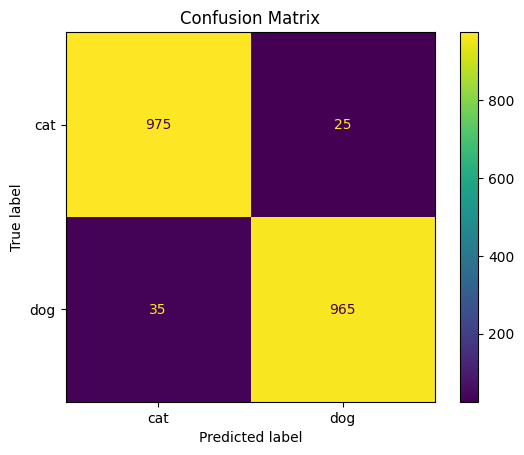

In [454]:
conf_mat = confusion_matrix(test_labels, y_test_pred_binary)
print(f'Confusion matrix:\n {conf_mat}')
conf_mat_dis = ConfusionMatrixDisplay(conf_mat, display_labels=['cat', 'dog'])
conf_mat_dis.plot()
conf_mat_dis.ax_.set_title('Confusion Matrix')
plt.show()

### Precision, Recall and F1

In [455]:
report = classification_report(test_labels, y_test_pred_binary)
report_df = pd.DataFrame(classification_report(test_labels, y_test_pred_binary, output_dict=True)).T
report_df

,precision,recall,f1-score,support
0,0.965347,0.975,0.970149,1000.00
1,0.974747,0.965,0.969849,1000.00
accuracy,0.970000,0.970,0.970000,0.97
macro avg,0.970047,0.970,0.969999,2000.00
weighted avg,0.970047,0.970,0.969999,2000.00


### Precision Recall Curve

In [456]:
precision, recall, thresholds = precision_recall_curve(test_labels, y_test_pred.flatten())

In [457]:
threshold = 0.9

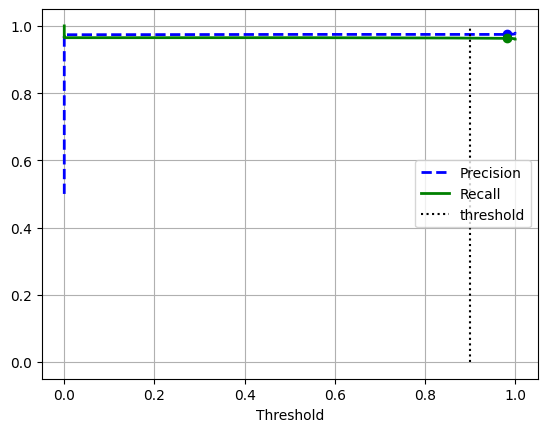

In [458]:
plt.plot(thresholds, precision[:-1], "b--", label="Precision", linewidth=2)
plt.plot(thresholds, recall[:-1], "g-", label="Recall", linewidth=2)


plt.vlines(threshold, 0, 1.0, "k", "dotted", label="threshold")
idx = (thresholds >= threshold).argmax()  # first index ≥ threshold
plt.plot(thresholds[idx], precision[idx], "bo")
plt.plot(thresholds[idx], recall[idx], "go")


plt.xlabel("Threshold")
plt.legend(loc="center right")
plt.grid(True)
plt.show()

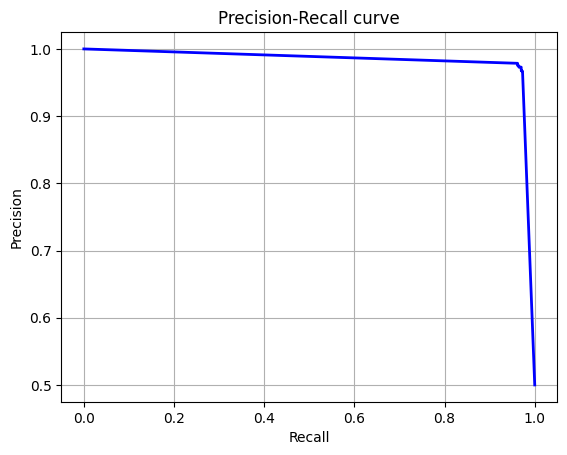

In [459]:
plt.plot(recall, precision, "b-", linewidth=2)
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.grid(True)
plt.title('Precision-Recall curve')
plt.show()

In [460]:
predictions_df = pd.DataFrame({
    'Probability': y_test_pred.flatten().round(6),
    'Predicted_Class': y_test_pred_binary,
    'Ground_Truth': test_labels
})

display(predictions_df)

,Probability,Predicted_Class,Ground_Truth
0,1.0,1,1
1,1.0,1,1
2,0.0,0,0
3,0.0,0,0
4,1.0,1,1
...,...,...,...
1995,1.0,1,1
1996,1.0,1,1
1997,1.0,1,1
1998,0.0,0,0


In [461]:
# Filter rows where Predicted_Class does not match Ground_Truth
mismatch_df = predictions_df[predictions_df['Predicted_Class'] != predictions_df['Ground_Truth']]

display(mismatch_df)

,Probability,Predicted_Class,Ground_Truth
60,1.000000,1,0
119,1.000000,1,0
153,1.000000,1,0
165,0.000000,0,1
166,0.000000,0,1
167,1.000000,1,0
168,1.000000,1,0
172,1.000000,1,0
175,0.000000,0,1
207,1.000000,1,0


In [462]:
len(mismatch_df)

60

We have 60 cases where our model incorrectly predicted the label on our test dataset. We will look into these instaces shortly.

## Model 2 Evaluation

When we manually use the performance metrics from sklearn, it shuffles our data and we don't want to shuffle the data from the predictions of our finetuned model because it will mess up our score.

To fix this, we store the labels before we do compute the performance scores.

Solution gotten from - https://stackoverflow.com/a/71814816/13959748

In [463]:
test_labels = []
test_images = []

for images, labels in test_dataset:
    test_labels.extend(labels.numpy()) 
    test_images.extend(images.numpy())  

test_images_dataset = tf.data.Dataset.from_tensor_slices(test_images).batch(16)


### Accuracy

In [464]:
y_test_pred = best_model_2.predict(test_images_dataset)

125/125 [==============================] - 94s 750ms/step


In [465]:
y_test_pred

array([[1.0000000e+00],
       [2.0270474e-05],
       [2.1983158e-18],
       ...,
       [6.3825097e-15],
       [1.0000000e+00],
       [1.0000000e+00]], dtype=float32)

In [466]:
y_test_pred_binary = (y_test_pred > 0.5).astype("int32").flatten()

In [467]:
manual_accuracy = accuracy_score(test_labels, y_test_pred_binary)
print(f'Manually Calculated Accuracy: {manual_accuracy}')

Manually Calculated Accuracy: 0.956


Here is the inbuilt keras accuracy evaluation and you can see it matches exactly with the one above, so our accuracy computation was correct and we can proceed with our other performance metrics.

In [468]:
# Now, the manual accuracy should match the built-in evaluate accuracy
test_loss, test_acc = best_model_2.evaluate(test_dataset)
print(f'Evaluate Accuracy: {test_acc}')

63/63 [==============================] - 100s 2s/step - loss: 0.3981 - accuracy: 0.9560
Evaluate Accuracy: 0.9559999704360962


### Confusion Matrix

Confusion matrix:
 [[962  38]
 [ 50 950]]


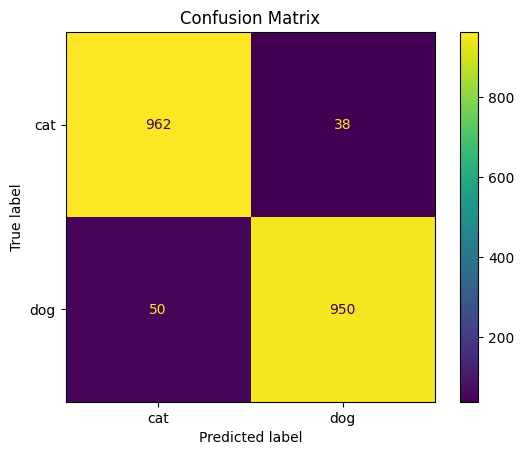

In [469]:
conf_mat = confusion_matrix(test_labels, y_test_pred_binary)
print(f'Confusion matrix:\n {conf_mat}')
conf_mat_dis = ConfusionMatrixDisplay(conf_mat, display_labels=['cat', 'dog'])
conf_mat_dis.plot()
conf_mat_dis.ax_.set_title('Confusion Matrix')
plt.show()

### Precision, Recall and F1

In [470]:
report = classification_report(test_labels, y_test_pred_binary)
report_df = pd.DataFrame(classification_report(test_labels, y_test_pred_binary, output_dict=True)).T
report_df

,precision,recall,f1-score,support
0,0.950593,0.962,0.956262,1000.000
1,0.961538,0.950,0.955734,1000.000
accuracy,0.956000,0.956,0.956000,0.956
macro avg,0.956066,0.956,0.955998,2000.000
weighted avg,0.956066,0.956,0.955998,2000.000


### Precision Recall Curve

In [471]:
precision, recall, thresholds = precision_recall_curve(test_labels, y_test_pred.flatten())

In [472]:
threshold = 0.9

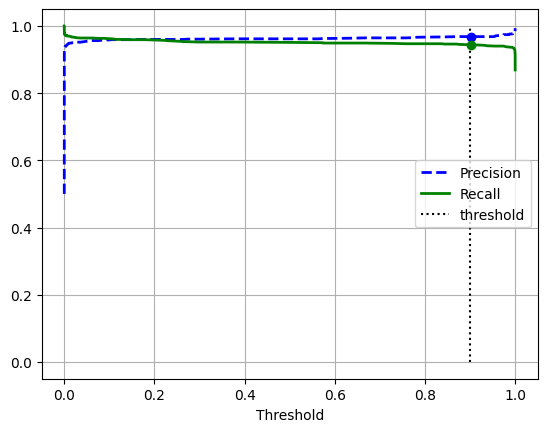

In [473]:
plt.plot(thresholds, precision[:-1], "b--", label="Precision", linewidth=2)
plt.plot(thresholds, recall[:-1], "g-", label="Recall", linewidth=2)


plt.vlines(threshold, 0, 1.0, "k", "dotted", label="threshold")
idx = (thresholds >= threshold).argmax()  # first index ≥ threshold
plt.plot(thresholds[idx], precision[idx], "bo")
plt.plot(thresholds[idx], recall[idx], "go")


plt.xlabel("Threshold")
plt.legend(loc="center right")
plt.grid(True)
plt.show()

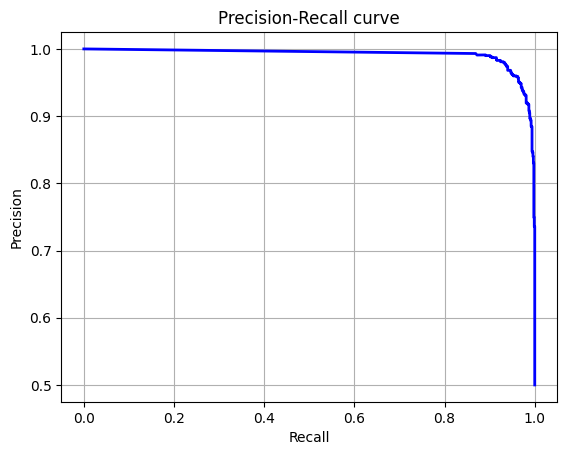

In [474]:
plt.plot(recall, precision, "b-", linewidth=2)
plt.xlabel("Recall")
plt.ylabel("Precision")
plt.grid(True)
plt.title('Precision-Recall curve')
plt.show()

In [475]:
predictions_df = pd.DataFrame({
    'Probability': y_test_pred.flatten().round(6),
    'Predicted_Class': y_test_pred_binary,
    'Ground_Truth': test_labels
})

display(predictions_df)

,Probability,Predicted_Class,Ground_Truth
0,1.00000,1,1
1,0.00002,0,0
2,0.00000,0,0
3,0.00061,0,0
4,1.00000,1,1
...,...,...,...
1995,1.00000,1,1
1996,0.00000,0,0
1997,0.00000,0,0
1998,1.00000,1,1


In [476]:
mismatch_df = predictions_df[predictions_df['Predicted_Class'] != predictions_df['Ground_Truth']]

display(mismatch_df)


,Probability,Predicted_Class,Ground_Truth
34,0.009803,0,1
86,0.843140,1,0
167,0.000017,0,1
184,1.000000,1,0
192,0.563013,1,0
...,...,...,...
1904,1.000000,1,0
1953,0.000014,0,1
1967,1.000000,1,0
1982,0.001493,0,1


In [477]:
mismatch_indices = mismatch_df.index.tolist()
len(mismatch_indices)

88

88 cases where the model got the predictions wrong.

In [480]:
def visualize_mismatches(dataset, mismatch_indices, max_images=10):
    # Initialize counters
    count, img_count = 0, 0
    for images, labels in dataset.unbatch().batch(1):  # Iterate over individual images
        if count in mismatch_indices:  # Check if the current image is a mismatch
            plt.figure(figsize=(2, 2))
            plt.imshow(images[0].numpy().astype("uint8"))
            plt.title(f'Index: {count}')
            plt.axis('off')
            plt.show()

            img_count += 1
            if img_count >= max_images:
                break
        count += 1


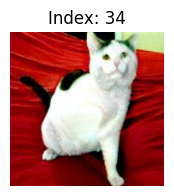

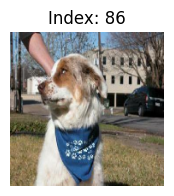

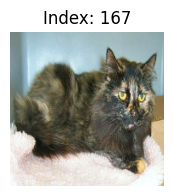

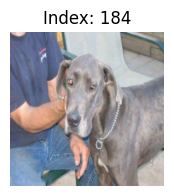

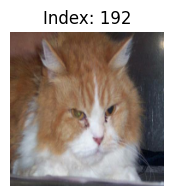

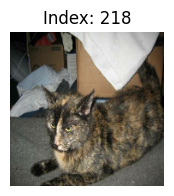

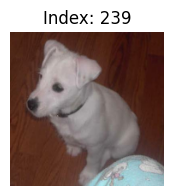

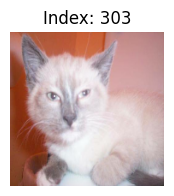

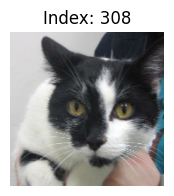

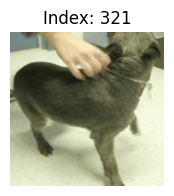

In [481]:
visualize_mismatches(test_dataset, mismatch_indices)

After going through some of the instances where the model failed, I noticed that in some of those images, the images were either blurry, there was some noise in the image, the animal wasn't facing the camera, the head of the animal wasn't showing properly, there was a human in the image as well, there were multiple animals in the image.

All of the above in different instances were why the model failed. Although the first model was still able to get the correct predictions in some of the cases and the second model also got some cases that the first model failed.

# Conclusion

After successfully training and evaluating two models, one vanilla, created from scratch and the other a fine tuned VGG16 model.

It was interesting to see that the vanilla model had a better performance on both the validation data and the test data, compared to the VGG16 model. The accuracy and precision difference are quite small but still, the slightly better performance was rather interesting.

The Vanilla model had an accuracy score of `97.0%` on the test set while the finetuned VGG6 model had a score of `95.6%`.

The Class 0 (Cat) had a lower precision than the Class 1 (Dog) on both models, `96.53%` and `95.0%` respectively. Similary, or rather, conversely, in terms of recall, the Class 0 (Cat) did better than the other class, scoring `97.5%` and `96.2%`.